In [7]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import solve_ivp
import ipywidgets as widgets
from IPython.display import display, clear_output

# =================================================
# N-BODY PHYSICS
# =================================================

def nbody_derivatives(t, state, masses, G=6.67430e-11):
    n = len(masses)
    pos = state[:2*n].reshape(n, 2)
    vel = state[2*n:].reshape(n, 2)
    acc = np.zeros_like(pos)

    for i in range(n):
        for j in range(n):
            if i == j:
                continue
            r = pos[j] - pos[i]
            dist2 = np.dot(r, r) + 1e-10
            acc[i] += G * masses[j] * r / (dist2**1.5)

    return np.hstack([vel.flatten(), acc.flatten()])


def simulate_system(masses, pos0, vel0, days=200, max_points=6000):
    T = days * 86400
    t_eval = np.linspace(0, T, max_points)
    y0 = np.hstack([pos0.flatten(), vel0.flatten()])

    sol = solve_ivp(
        nbody_derivatives,
        (0, T),
        y0,
        t_eval=t_eval,
        args=(masses,),
        rtol=1e-9, atol=1e-9
    )
    return sol


def plot_orbits(sol, masses):
    n = len(masses)
    pos = sol.y[:2*n].reshape(n, 2, -1)

    planet_names = ["Sun", "Mercury", "Venus", "Earth", "Mars"]
    colors = ["gold", "gray", "orange", "blue", "red"]

    plt.figure(figsize=(8,8))

    for i in range(n):
        plt.plot(pos[i,0], pos[i,1], label=planet_names[i], color=colors[i], lw=1.8)
        plt.scatter(pos[i,0,0], pos[i,1,0], s=50, color=colors[i])

    plt.axis("equal")
    plt.grid(True)
    plt.legend()
    plt.xlabel("x (m)")
    plt.ylabel("y (m)")
    plt.title("N-Body Simulation (Inner Solar System)")
    plt.show()



# =================================================
# SOLAR SYSTEM PARAMETERS
# =================================================

def get_solar_system():
    masses = {
        "Sun": 1.99e30,
        "Mercury": 3.30e23,
        "Venus": 4.87e24,
        "Earth": 5.97e24,
        "Mars": 6.42e23
    }

    positions = {
        "Sun": np.array([0, 0]),
        "Mercury": np.array([5.79e10, 0]),
        "Venus": np.array([1.08e11, 0]),
        "Earth": np.array([0, 1.50e11]),
        "Mars": np.array([0, 2.28e11])
    }

    velocities = {
        "Sun": np.array([0, 0]),
        "Mercury": np.array([0, 4.79e4]),
        "Venus": np.array([0, 3.50e4]),
        "Earth": np.array([2.98e4, 0]),
        "Mars": np.array([2.41e4, 0])
    }

    return masses, positions, velocities


def modify_system(masses, positions, velocities, changes):
    for body, params in changes.items():
        if "mass" in params:
            masses[body] = params["mass"]
        if "vx" in params:
            velocities[body][0] = params["vx"]
        if "vy" in params:
            velocities[body][1] = params["vy"]
    return masses, positions, velocities


def reset_system():
    return get_solar_system()


def system_to_arrays(masses, positions, velocities):
    order = ["Sun", "Mercury", "Venus", "Earth", "Mars"]
    mass_list = [masses[o] for o in order]
    pos_array = np.array([positions[o] for o in order])
    vel_array = np.array([velocities[o] for o in order])
    return mass_list, pos_array, vel_array


# =================================================
# PHASE SPACE PLOT
# =================================================

def plot_phase_space(sol, masses, AU=1.496e11):
    n = len(masses)
    pos = sol.y[:2*n].reshape(n,2,-1)
    vel = sol.y[2*n:].reshape(n,2,-1)

    planet_names = ["Sun", "Mercury", "Venus", "Earth", "Mars"]
    colors = ["gold", "gray", "orange", "blue", "red"]

    plt.figure(figsize=(7,5))

    for i in range(1, n):
        r_vec = pos[i] - pos[0]  # relative to Sun
        r = np.linalg.norm(r_vec, axis=0) / AU
        vr = np.sum(r_vec * vel[i], axis=0) / (np.linalg.norm(r_vec, axis=0) + 1e-12)

        plt.plot(r, vr, lw=1.5, color=colors[i], label=planet_names[i])

    plt.grid(True, alpha=0.3)
    plt.xlabel("Radial Distance r (AU)")
    plt.ylabel("Radial Speed vᵣ (m/s)")
    plt.title("Phase Space Diagram (r vs vᵣ)")
    plt.legend()
    plt.show()


In [23]:
planet_dropdown = widgets.Dropdown(
    options=["Sun", "Mercury", "Venus", "Earth", "Mars"],
    value="Earth",
    description="Planet:"
)

mass_slider = widgets.FloatSlider(
    value=1.0, min=0, max=5.0, step=0.2,
    description='Mass ×',
    continuous_update=False
)

vx_slider = widgets.FloatSlider(
    value=0.0, min=-10000, max=10000, step=1000,
    description='vx Δ',
    continuous_update=False
)

vy_slider = widgets.FloatSlider(
    value=0.0, min=-10000, max=10000, step=1000,
    description='vy Δ',
    continuous_update=False
)

apply_button = widgets.Button(description="Apply", button_style='success')
reset_button = widgets.Button(description="Reset", button_style='warning')

out = widgets.Output()


def apply_changes(b):
    with out:
        clear_output()

        # Step 1: get default solar system
        masses, positions, velocities = reset_system()

        # Step 2: read UI modifications
        planet = planet_dropdown.value
        changes = {
            planet: {
                "mass": mass_slider.value * masses[planet],
                "vx": velocities[planet][0] + vx_slider.value,
                "vy": velocities[planet][1] + vy_slider.value
            }
        }

        # Step 3: apply modifications
        masses, positions, velocities = modify_system(masses, positions, velocities, changes)

        # Step 4: convert dict → arrays for simulation
        mass_list, pos0, vel0 = system_to_arrays(masses, positions, velocities)

        # Step 5: simulate system
        sol = simulate_system(mass_list, pos0, vel0, days=600)

        # Step 6: plot output
        plot_orbits(sol, mass_list)
        plot_phase_space(sol, mass_list)

        print(f"{planet} updated.")
        print(f"Mass = {masses[planet]:.3e} kg")
        print(f"vx = {velocities[planet][0]:.1f} m/s, vy = {velocities[planet][1]:.1f} m/s")

        apply_changes.last_sol = sol
        apply_changes.last_masses = mass_list


def reset_system_ui(b):
    with out:
        clear_output()
        print("Solar system reset. Click Apply to simulate.")


apply_button.on_click(apply_changes)
reset_button.on_click(reset_system_ui)

ui = widgets.VBox([
    planet_dropdown,
    mass_slider,
    vx_slider,
    vy_slider,
    widgets.HBox([apply_button, reset_button]),
    out
])

display(ui)


In [26]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import matplotlib.ticker as ticker
from matplotlib.collections import LineCollection
from matplotlib import colors as mcolors   # color faded very cool 芜湖

def animate_orbits_au(sol, masses, stride=10, interval=20, trail_length=200):
    AU = 1.496e11

    planet_names = ["Sun", "Mercury", "Venus", "Earth", "Mars"]
    colors = ["gold", "gray", "orange", "blue", "red"]

    n = len(masses)
    pos = sol.y[:2*n].reshape(n, 2, -1) / AU
    pos = pos[:, :, ::stride]
    frames = pos.shape[2]

    fig, ax = plt.subplots(figsize=(7,7))
    ax.set_aspect("equal")
    ax.grid(True, alpha=0.3)

    ax.set_xlabel("x (AU)")
    ax.set_ylabel("y (AU)")

    ax.ticklabel_format(useOffset=False, style='plain')
    ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%.2f'))
    ax.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.2f'))

    all_x = pos[:,0,:].flatten()
    all_y = pos[:,1,:].flatten()
    span = max(all_x.max() - all_x.min(), all_y.max() - all_y.min())
    pad = 0.2 * span
    ax.set_xlim(all_x.min() - pad, all_x.max() + pad)
    ax.set_ylim(all_y.min() - pad, all_y.max() + pad)

    # fading trail + dots
    linecols = []
    dots = []

    for i in range(n):
        lc = LineCollection([], linewidth=1.5)
        ax.add_collection(lc)
        linecols.append(lc)

        dot, = ax.plot([], [], 'o', markersize=8 if i == 0 else 6, color=colors[i])
        dots.append(dot)

    ax.legend([dots[i] for i in range(n)], planet_names, loc="upper right")

    def update(frame):
        for i in range(n):
            x = pos[i,0]
            y = pos[i,1]

            start = max(0, frame - trail_length)
            xx = x[start:frame]
            yy = y[start:frame]

            if len(xx) > 1:
                seg = np.stack([xx[:-1], yy[:-1], xx[1:], yy[1:]], axis=1).reshape(-1,2,2)
            else:
                seg = np.empty((0,2,2))

            if len(seg) > 0:
                alphas = np.linspace(0.05, 1.0, len(seg))
                rgba_colors = [mcolors.to_rgba(colors[i], alpha=a) for a in alphas]  # ⭐ FIXED
                linecols[i].set_segments(seg)
                linecols[i].set_color(rgba_colors)

            dots[i].set_data(x[frame], y[frame])

        return linecols + dots

    anim = FuncAnimation(fig, update, frames=frames, interval=interval, blit=False)
    return HTML(anim.to_jshtml())


Animation created. Run next cell to save as MP4.


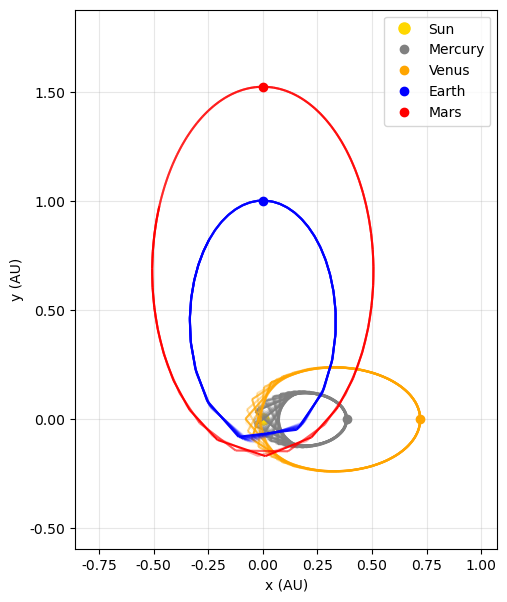

In [27]:
try:
    anim = animate_orbits_au(
        apply_changes.last_sol, 
        apply_changes.last_masses,
        stride=20
    )

    display(anim)
    print("Animation created. Run next cell to save as MP4.")

except AttributeError:
    print("Please click Apply first!")


